# Load the libraries

In [1]:
import os
import folium
import pandas as pd
import seaborn as sns
import geopandas as gpd
import numpy as np
import plotly.express as px
import matplotlib
import matplotlib.pyplot as plt
from shapely.geometry import MultiPolygon, Polygon
from shapely.wkt import loads, dumps
from matplotlib import cm
from matplotlib.colors import Normalize, rgb2hex
import branca
from branca.element import Element
import plotly.express as px
import plotly.colors as pc
import branca.colormap as cm
from shapely.wkt import loads
from folium import Element
from matplotlib.colors import Normalize, rgb2hex


# Import Datasets

In [2]:
# Load the datasets
neighbourhood_profiles_df = pd.read_csv('clean_data/pivoted_neighbourhood_profiles.csv') #neighborhood profiles with income
pollinateTO_df = pd.read_csv("clean_data/PollinateTO_cleaned.csv")

# Define the directory where the CSV files are saved
save_directory = "clean_data"

# List of filenames to open
filenames = [
    "geocoded_df.csv",
    "neighbourhoods_df_cleaned.csv",
    "parks_df.csv",
    "schools_df.csv",
    "filtered_gdf.csv"
]

# Dictionary to store the DataFrames
dataframes = {}

# Loop through the filenames and read the CSVs into DataFrames
for filename in filenames:
    file_path = os.path.join(save_directory, filename)
    dataframes[filename] = pd.read_csv(file_path)

# Access the loaded DataFrames by filename (example)
development_applications_geocoded_df = dataframes.get("Development_Applications_development_applications") # development applications
neighbourhoods_shapefiles_df = dataframes.get("neighbourhoods_df_cleaned.csv") #geometry shape file
parks_df = dataframes.get("parks_df.csv") # parks data
schools_df = dataframes.get("schools_df.csv") # school data
homeless_cleaned_gdf = dataframes.get("filtered_gdf.csv") # homeless shelter data

# Let's start with analysis of Neighborhood Incomes Data
Let's load the dataframe and see what we have

In [3]:
neighbourhood_profiles_df.head(15)

,Unnamed: 0,0,2,3,4,5,6,7,8,9,...,11,12,13,14,15,16,17,18,19,20
0,_id,1,3,2099,2101,2109,2081,1343,2102,1054,...,2106,2108,2110,2112,2097,2114,2116,2118,2120,2122
1,Category,Neighbourhood Information,Population,Income,Income,Income,Income,Income,Income,Income,...,Income,Income,Income,Income,Income,Income,Income,Income,Income,Income
2,Topic,Neighbourhood Information,Population and dwellings,Income of households in 2015,Income of households in 2015,Income of households in 2015,Income of households in 2015,Income of households in 2015,Income of households in 2015,Income of households in 2015,...,Income of households in 2015,Income of households in 2015,Income of households in 2015,Income of households in 2015,Income of households in 2015,Income of households in 2015,Income of households in 2015,Income of households in 2015,Income of households in 2015,Income of households in 2015
3,Characteristic,Neighbourhood Number,"Population, 2016","$10,000 to $14,999","$100,000 to $124,999","$125,000 to $149,999","$15,000 to $19,999","$150,000 to $199,999","$20,000 to $24,999","$200,000 and over",...,"$30,000 to $34,999","$35,000 to $39,999","$40,000 to $44,999","$45,000 to $49,999","$5,000 to $9,999","$50,000 to $59,999","$60,000 to $69,999","$70,000 to $79,999","$80,000 to $89,999","$90,000 to $99,999"
4,City of Toronto,NaN,2731571.0,73630.0,194830.0,126560.0,109955.0,188995.0,99225.0,96600.0,...,100460.0,102660.0,102055.0,98035.0,47070.0,183090.0,162875.0,143310.0,123760.0,105055.0
5,Agincourt North,129.0,29113.0,325.0,1890.0,1105.0,900.0,1105.0,660.0,325.0,...,870.0,965.0,875.0,910.0,210.0,1730.0,1455.0,1330.0,1165.0,1015.0
6,Agincourt South-Malvern West,128.0,23757.0,400.0,1490.0,845.0,540.0,900.0,665.0,285.0,...,765.0,835.0,840.0,860.0,270.0,1630.0,1400.0,1225.0,1010.0,810.0
7,Alderwood,20.0,12054.0,160.0,1125.0,925.0,175.0,1030.0,305.0,360.0,...,325.0,380.0,345.0,390.0,80.0,725.0,655.0,685.0,585.0,515.0
8,Annex,95.0,30526.0,1315.0,2425.0,1685.0,1525.0,3895.0,1300.0,2670.0,...,1155.0,1230.0,1185.0,1170.0,970.0,2160.0,1960.0,1615.0,1465.0,1225.0
9,Banbury-Don Mills,42.0,27695.0,480.0,2165.0,1440.0,835.0,2850.0,825.0,1750.0,...,905.0,1045.0,1015.0,975.0,305.0,2110.0,1885.0,1570.0,1345.0,1200.0


Let's remove the row with city of Toronto values since we are looking at information at neighborhood level. 

In [4]:
# Drop the rows with indices 0, 1, 2, and 4
neighbourhood_profiles_df = neighbourhood_profiles_df.drop(index=[0, 1, 2, 4])

# Verify the rows have been removed
neighbourhood_profiles_df.head(5)

,Unnamed: 0,0,2,3,4,5,6,7,8,9,...,11,12,13,14,15,16,17,18,19,20
3,Characteristic,Neighbourhood Number,"Population, 2016","$10,000 to $14,999","$100,000 to $124,999","$125,000 to $149,999","$15,000 to $19,999","$150,000 to $199,999","$20,000 to $24,999","$200,000 and over",...,"$30,000 to $34,999","$35,000 to $39,999","$40,000 to $44,999","$45,000 to $49,999","$5,000 to $9,999","$50,000 to $59,999","$60,000 to $69,999","$70,000 to $79,999","$80,000 to $89,999","$90,000 to $99,999"
5,Agincourt North,129.0,29113.0,325.0,1890.0,1105.0,900.0,1105.0,660.0,325.0,...,870.0,965.0,875.0,910.0,210.0,1730.0,1455.0,1330.0,1165.0,1015.0
6,Agincourt South-Malvern West,128.0,23757.0,400.0,1490.0,845.0,540.0,900.0,665.0,285.0,...,765.0,835.0,840.0,860.0,270.0,1630.0,1400.0,1225.0,1010.0,810.0
7,Alderwood,20.0,12054.0,160.0,1125.0,925.0,175.0,1030.0,305.0,360.0,...,325.0,380.0,345.0,390.0,80.0,725.0,655.0,685.0,585.0,515.0
8,Annex,95.0,30526.0,1315.0,2425.0,1685.0,1525.0,3895.0,1300.0,2670.0,...,1155.0,1230.0,1185.0,1170.0,970.0,2160.0,1960.0,1615.0,1465.0,1225.0


In [5]:
# Set the first row as the header
neighbourhood_profiles_df.columns = neighbourhood_profiles_df.iloc[0]

# Drop the first row now that it is set as the header
neighbourhood_profiles_df = neighbourhood_profiles_df.iloc[1:]

# Reset the index if needed
neighbourhood_profiles_df.reset_index(drop=True, inplace=True)

# Verify the changes
neighbourhood_profiles_df.head(5)

3,Characteristic,Neighbourhood Number,"Population, 2016","$10,000 to $14,999","$100,000 to $124,999","$125,000 to $149,999","$15,000 to $19,999","$150,000 to $199,999","$20,000 to $24,999","$200,000 and over",...,"$30,000 to $34,999","$35,000 to $39,999","$40,000 to $44,999","$45,000 to $49,999","$5,000 to $9,999","$50,000 to $59,999","$60,000 to $69,999","$70,000 to $79,999","$80,000 to $89,999","$90,000 to $99,999"
0,Agincourt North,129.0,29113.0,325.0,1890.0,1105.0,900.0,1105.0,660.0,325.0,...,870.0,965.0,875.0,910.0,210.0,1730.0,1455.0,1330.0,1165.0,1015.0
1,Agincourt South-Malvern West,128.0,23757.0,400.0,1490.0,845.0,540.0,900.0,665.0,285.0,...,765.0,835.0,840.0,860.0,270.0,1630.0,1400.0,1225.0,1010.0,810.0
2,Alderwood,20.0,12054.0,160.0,1125.0,925.0,175.0,1030.0,305.0,360.0,...,325.0,380.0,345.0,390.0,80.0,725.0,655.0,685.0,585.0,515.0
3,Annex,95.0,30526.0,1315.0,2425.0,1685.0,1525.0,3895.0,1300.0,2670.0,...,1155.0,1230.0,1185.0,1170.0,970.0,2160.0,1960.0,1615.0,1465.0,1225.0
4,Banbury-Don Mills,42.0,27695.0,480.0,2165.0,1440.0,835.0,2850.0,825.0,1750.0,...,905.0,1045.0,1015.0,975.0,305.0,2110.0,1885.0,1570.0,1345.0,1200.0


In [6]:
# Explicitly make a copy to avoid SettingWithCopyWarning
neighbourhood_profiles_df = neighbourhood_profiles_df.copy()

# Rename the column 'Characteristic' to 'Neighbourhood Name'
neighbourhood_profiles_df.rename(columns={"Characteristic": "Neighbourhood Name"}, inplace=True)

# Verify the change
neighbourhood_profiles_df.head()

3,Neighbourhood Name,Neighbourhood Number,"Population, 2016","$10,000 to $14,999","$100,000 to $124,999","$125,000 to $149,999","$15,000 to $19,999","$150,000 to $199,999","$20,000 to $24,999","$200,000 and over",...,"$30,000 to $34,999","$35,000 to $39,999","$40,000 to $44,999","$45,000 to $49,999","$5,000 to $9,999","$50,000 to $59,999","$60,000 to $69,999","$70,000 to $79,999","$80,000 to $89,999","$90,000 to $99,999"
0,Agincourt North,129.0,29113.0,325.0,1890.0,1105.0,900.0,1105.0,660.0,325.0,...,870.0,965.0,875.0,910.0,210.0,1730.0,1455.0,1330.0,1165.0,1015.0
1,Agincourt South-Malvern West,128.0,23757.0,400.0,1490.0,845.0,540.0,900.0,665.0,285.0,...,765.0,835.0,840.0,860.0,270.0,1630.0,1400.0,1225.0,1010.0,810.0
2,Alderwood,20.0,12054.0,160.0,1125.0,925.0,175.0,1030.0,305.0,360.0,...,325.0,380.0,345.0,390.0,80.0,725.0,655.0,685.0,585.0,515.0
3,Annex,95.0,30526.0,1315.0,2425.0,1685.0,1525.0,3895.0,1300.0,2670.0,...,1155.0,1230.0,1185.0,1170.0,970.0,2160.0,1960.0,1615.0,1465.0,1225.0
4,Banbury-Don Mills,42.0,27695.0,480.0,2165.0,1440.0,835.0,2850.0,825.0,1750.0,...,905.0,1045.0,1015.0,975.0,305.0,2110.0,1885.0,1570.0,1345.0,1200.0


In [7]:
# Update income_ranges keys to match the current column names
income_ranges = {
    "$10,000 to $14,999": (10000, 14999),
    "$15,000 to $19,999": (15000, 19999),
    "$20,000 to $24,999": (20000, 24999),
    "$25,000 to $29,999": (25000, 29999),
    "$30,000 to $34,999": (30000, 34999),
    "$35,000 to $39,999": (35000, 39999),
    "$40,000 to $44,999": (40000, 44999),
    "$45,000 to $49,999": (45000, 49999),
    "$50,000 to $59,999": (50000, 59999),
    "$60,000 to $69,999": (60000, 69999),
    "$70,000 to $79,999": (70000, 79999),
    "$80,000 to $89,999": (80000, 89999),
    "$90,000 to $99,999": (90000, 99999),
    "$100,000 to $124,999": (100000, 124999),
    "$125,000 to $149,999": (125000, 149999),
    "$150,000 to $199,999": (150000, 199999),
    "$200,000 and over": (200000, 200000)  # Fixed upper bound
}

# Convert income-related columns to numeric
for col in income_ranges.keys():
    if col in neighbourhood_profiles_df.columns:
        neighbourhood_profiles_df[col] = pd.to_numeric(neighbourhood_profiles_df[col], errors='coerce')

# Prepare the new DataFrame
neighbourhood_income_and_population_df = neighbourhood_profiles_df[
    ["Neighbourhood Name", "Neighbourhood Number", "Population, 2016"]
].copy()

# Initialize variables to store lower and upper bound sums and total population
neighbourhood_income_and_population_df["Average Income (Lower Bound)"] = 0.0
neighbourhood_income_and_population_df["Average Income (Upper Bound)"] = 0.0

# Calculate the weighted income bounds for each neighborhood
for index, row in neighbourhood_profiles_df.iterrows():
    lower_bound_sum = 0
    upper_bound_sum = 0
    total_population = 0

    for col, (lower, upper) in income_ranges.items():
        if col in neighbourhood_profiles_df.columns and pd.notna(row[col]):
            population_in_bracket = row[col]
            if pd.notna(population_in_bracket):  # Handle missing values
                lower_bound_sum += population_in_bracket * lower
                upper_bound_sum += population_in_bracket * upper
                total_population += population_in_bracket

    # Calculate average bounds, avoiding division by zero
    if total_population > 0:
        avg_lower_bound = lower_bound_sum / total_population
        avg_upper_bound = upper_bound_sum / total_population
    else:
        avg_lower_bound = avg_upper_bound = 0

    # Assign calculated values to the new DataFrame
    neighbourhood_income_and_population_df.loc[index, "Average Income (Lower Bound)"] = avg_lower_bound
    neighbourhood_income_and_population_df.loc[index, "Average Income (Upper Bound)"] = avg_upper_bound

# Combine lower and upper bounds into a single column for readability
neighbourhood_income_and_population_df["Average Income"] = neighbourhood_income_and_population_df.apply(
    lambda x: f"{x['Average Income (Lower Bound)']:.0f} to {x['Average Income (Upper Bound)']:.0f}", axis=1
)

# Drop intermediate calculation columns
neighbourhood_income_and_population_df.drop(columns=["Average Income (Lower Bound)", "Average Income (Upper Bound)"], inplace=True)


# Display the first few rows of the DataFrame
neighbourhood_income_and_population_df.head(5)

3,Neighbourhood Name,Neighbourhood Number,"Population, 2016",Average Income
0,Agincourt North,129.0,29113.0,67836 to 80814
1,Agincourt South-Malvern West,128.0,23757.0,66721 to 79304
2,Alderwood,20.0,12054.0,82589 to 98839
3,Annex,95.0,30526.0,82585 to 97409
4,Banbury-Don Mills,42.0,27695.0,82435 to 97383


In [8]:
# Check for missing values in the new dataframe and verify the format of the "Population, 2016" column

# Check for missing values
missing_values = neighbourhood_income_and_population_df.isnull().sum()

# Check if "Population, 2016" is in the correct numeric format
population_dtype = neighbourhood_income_and_population_df["Population, 2016"].dtype

missing_values, population_dtype


(3
 Neighbourhood Name      0
 Neighbourhood Number    0
 Population, 2016        0
 Average Income          0
 dtype: int64,
 dtype('O'))

We need to convert the Population, 2016 column to a numeric format for visualizations. Let me fix this.

In [9]:
# Convert "Population, 2016" to numeric
neighbourhood_income_and_population_df["Population, 2016"] = pd.to_numeric(
    neighbourhood_income_and_population_df["Population, 2016"], errors="coerce"
)

# Verify the conversion and check for missing values again
population_dtype = neighbourhood_income_and_population_df["Population, 2016"].dtype
missing_values_after_conversion = neighbourhood_income_and_population_df.isnull().sum()

population_dtype, missing_values_after_conversion

(dtype('float64'),
 3
 Neighbourhood Name      0
 Neighbourhood Number    0
 Population, 2016        0
 Average Income          0
 dtype: int64)

In [10]:
# Create a new column for average income midpoints
neighbourhood_income_and_population_df["Average Income Midpoint"] = neighbourhood_income_and_population_df["Average Income"].apply(
    lambda x: (float(x.split(" to ")[0]) + float(x.split(" to ")[1])) / 2 if isinstance(x, str) else None
)

# Verify the new column
neighbourhood_income_and_population_df.head()

3,Neighbourhood Name,Neighbourhood Number,"Population, 2016",Average Income,Average Income Midpoint
0,Agincourt North,129.0,29113.0,67836 to 80814,74325.0
1,Agincourt South-Malvern West,128.0,23757.0,66721 to 79304,73012.5
2,Alderwood,20.0,12054.0,82589 to 98839,90714.0
3,Annex,95.0,30526.0,82585 to 97409,89997.0
4,Banbury-Don Mills,42.0,27695.0,82435 to 97383,89909.0


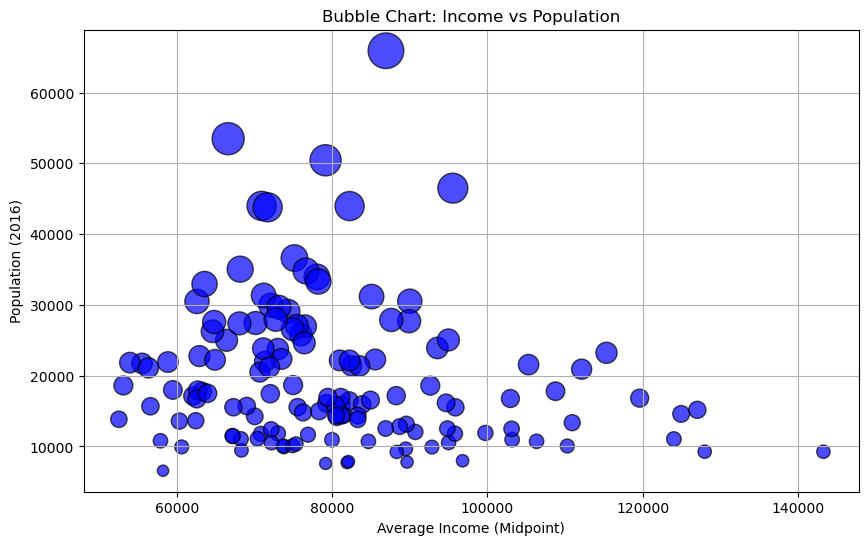

Chart saved as 'interactive_bubble_chart.html'


In [11]:
# Bubble Chart (corrected)
plt.figure(figsize=(10, 6))
plt.scatter(
    neighbourhood_income_and_population_df["Average Income Midpoint"],
    neighbourhood_income_and_population_df["Population, 2016"],
    s=neighbourhood_income_and_population_df["Population, 2016"] / 100,  # Scale bubble size
    alpha=0.7,
    color="blue",
    edgecolor="k"
)
plt.title("Bubble Chart: Income vs Population")
plt.xlabel("Average Income (Midpoint)")
plt.ylabel("Population (2016)")
plt.grid(True)
plt.show()

# Interactive Visualization with Plotly (corrected)
fig = px.scatter(
    neighbourhood_income_and_population_df,
    x="Average Income Midpoint",
    y="Population, 2016",
    size="Population, 2016",
    color="Neighbourhood Name",
    hover_name="Neighbourhood Name",
    title="Neighbourhood Profiles: Income vs Population",
    labels={"Average Income Midpoint": "Average Income (Midpoint)", "Population, 2016": "Population (2016)"}
)
fig.show()
#fig.write_html("EDA_maps/interactive_bubble_chart.html")
print("Chart saved as 'interactive_bubble_chart.html'")

In [12]:
# Generate a color sequence with a sufficient number of unique colors
unique_neighbourhoods = neighbourhood_income_and_population_df["Neighbourhood Name"].nunique()
color_sequence = pc.qualitative.Safe if unique_neighbourhoods <= len(pc.qualitative.Safe) else px.colors.qualitative.Alphabet

# Interactive Visualization with Plotly
fig = px.scatter(
    neighbourhood_income_and_population_df,
    x="Average Income Midpoint",
    y="Population, 2016",
    size="Population, 2016",
    color="Neighbourhood Name",
    hover_name="Neighbourhood Name",
    title="Neighbourhood Profiles: Income vs Population",
    labels={"Average Income Midpoint": "Average Income (Midpoint)", "Population, 2016": "Population (2016)"},
    color_discrete_sequence=color_sequence
)

fig.show()
#fig.write_html("EDA_maps/interactive_bubble_chart.html")
print("Chart saved as 'interactive_bubble_chart.html'")

Chart saved as 'interactive_bubble_chart.html'


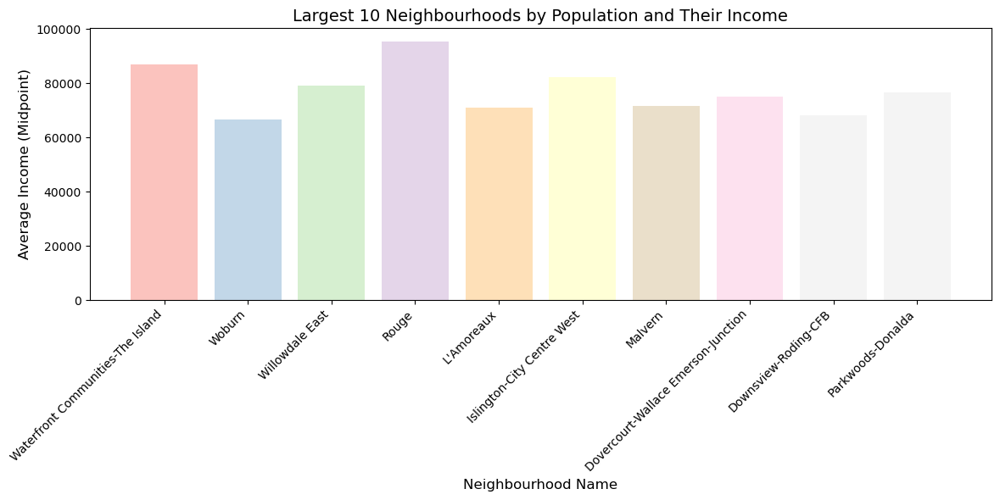

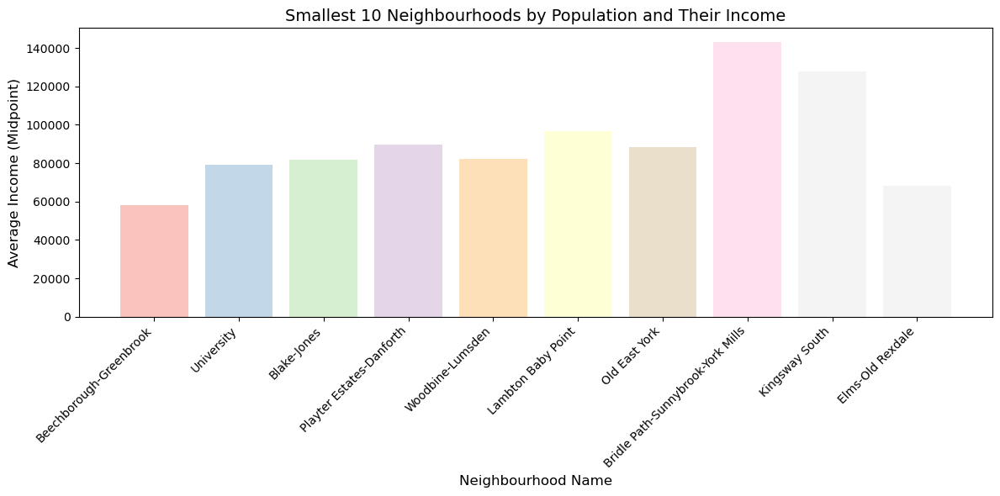

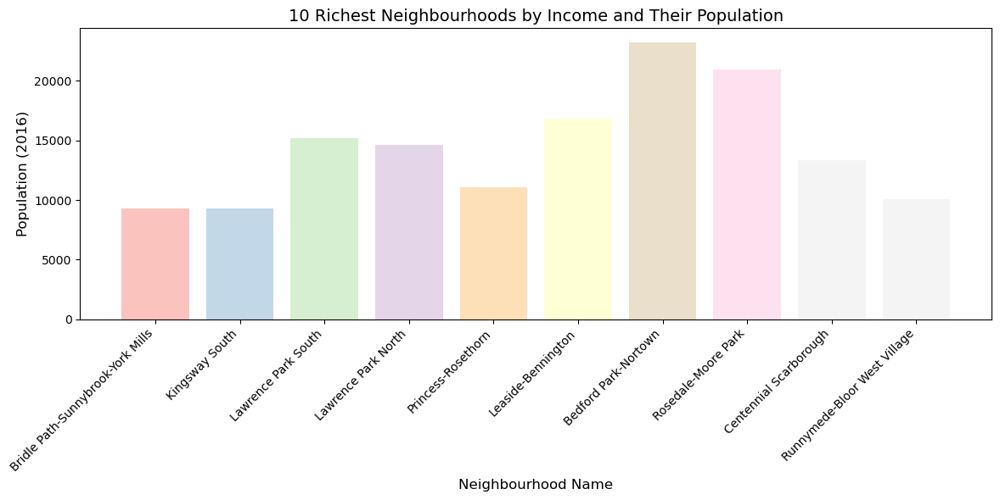

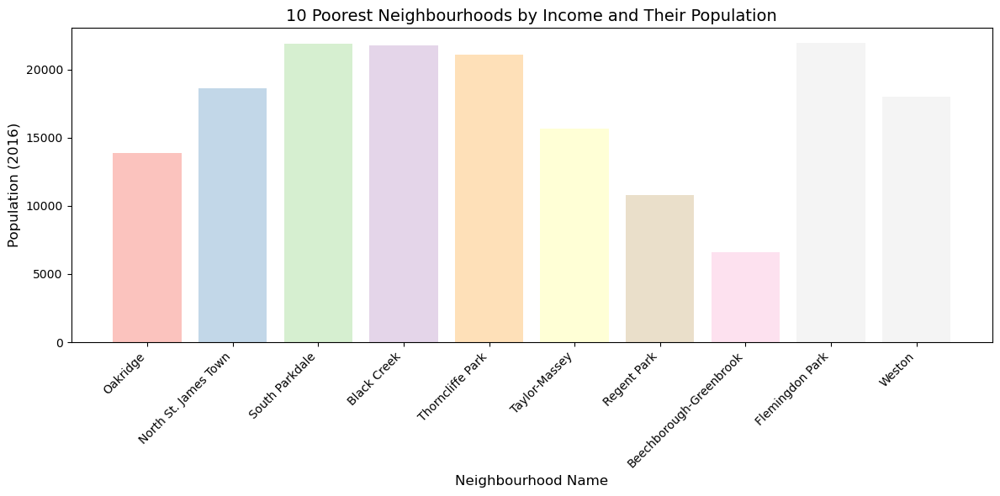

In [13]:
# Sort data for different visualizations
largest_neighbourhoods = neighbourhood_income_and_population_df.nlargest(10, "Population, 2016")
smallest_neighbourhoods = neighbourhood_income_and_population_df.nsmallest(10, "Population, 2016")
richest_neighbourhoods = neighbourhood_income_and_population_df.nlargest(10, "Average Income Midpoint")
poorest_neighbourhoods = neighbourhood_income_and_population_df.nsmallest(10, "Average Income Midpoint")

# Define a pastel color palette
colors = plt.cm.Pastel1(range(10))

# Largest 10 Neighbourhoods and their Income
plt.figure(figsize=(12, 6))
plt.bar(
    largest_neighbourhoods["Neighbourhood Name"],
    largest_neighbourhoods["Average Income Midpoint"],
    color=colors,
    alpha=0.8
)
plt.xticks(rotation=45, ha='right')
plt.title("Largest 10 Neighbourhoods by Population and Their Income", fontsize=14)
plt.xlabel("Neighbourhood Name", fontsize=12)
plt.ylabel("Average Income (Midpoint)", fontsize=12)
plt.tight_layout()
plt.show()

# Smallest 10 Neighbourhoods and their Income
plt.figure(figsize=(12, 6))
plt.bar(
    smallest_neighbourhoods["Neighbourhood Name"],
    smallest_neighbourhoods["Average Income Midpoint"],
    color=colors,
    alpha=0.8
)
plt.xticks(rotation=45, ha='right')
plt.title("Smallest 10 Neighbourhoods by Population and Their Income", fontsize=14)
plt.xlabel("Neighbourhood Name", fontsize=12)
plt.ylabel("Average Income (Midpoint)", fontsize=12)
plt.tight_layout()
plt.show()

# 10 Richest Neighbourhoods and their Population
plt.figure(figsize=(12, 6))
plt.bar(
    richest_neighbourhoods["Neighbourhood Name"],
    richest_neighbourhoods["Population, 2016"],
    color=colors,
    alpha=0.8
)
plt.xticks(rotation=45, ha='right')
plt.title("10 Richest Neighbourhoods by Income and Their Population", fontsize=14)
plt.xlabel("Neighbourhood Name", fontsize=12)
plt.ylabel("Population (2016)", fontsize=12)
plt.tight_layout()
plt.show()

# 10 Poorest Neighbourhoods and their Population
plt.figure(figsize=(12, 6))
plt.bar(
    poorest_neighbourhoods["Neighbourhood Name"],
    poorest_neighbourhoods["Population, 2016"],
    color=colors,
    alpha=0.8
)
plt.xticks(rotation=45, ha='right')
plt.title("10 Poorest Neighbourhoods by Income and Their Population", fontsize=14)
plt.xlabel("Neighbourhood Name", fontsize=12)
plt.ylabel("Population (2016)", fontsize=12)
plt.tight_layout()
plt.show()

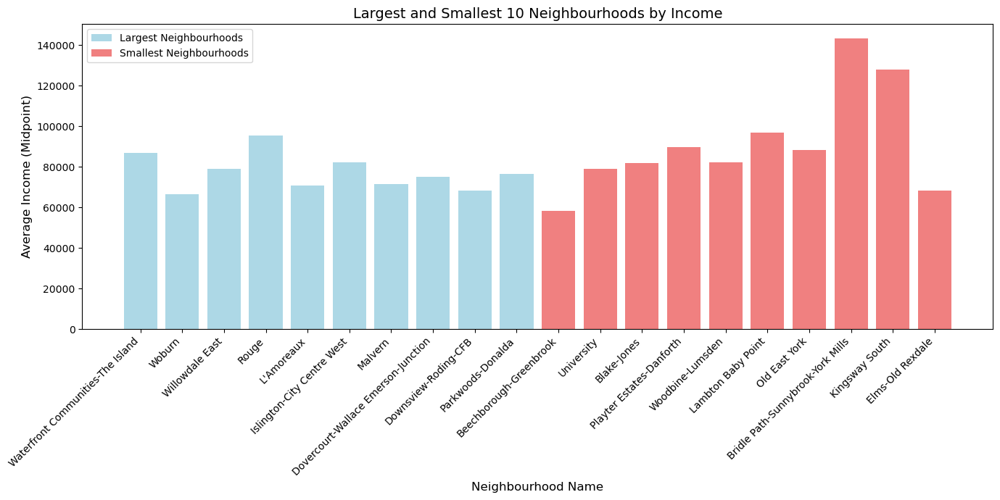

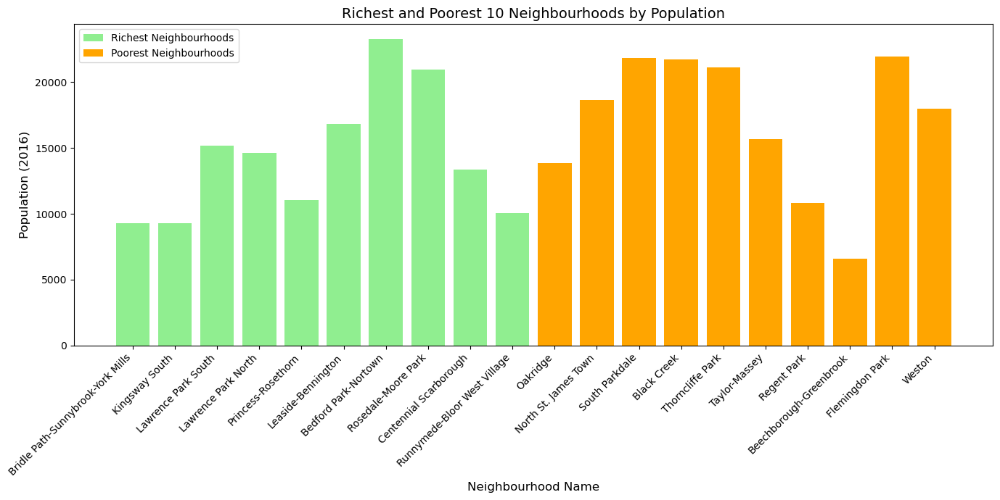

In [14]:
# Combined Graph: Largest and Smallest 10 Neighbourhoods by Income
plt.figure(figsize=(14, 7))

# Plot Largest 10 Neighbourhoods
plt.bar(
    largest_neighbourhoods["Neighbourhood Name"],
    largest_neighbourhoods["Average Income Midpoint"],
    color="lightblue",
    label="Largest Neighbourhoods"
)

# Plot Smallest 10 Neighbourhoods
plt.bar(
    smallest_neighbourhoods["Neighbourhood Name"],
    smallest_neighbourhoods["Average Income Midpoint"],
    color="lightcoral",
    label="Smallest Neighbourhoods"
)

plt.xticks(rotation=45, ha='right')
plt.title("Largest and Smallest 10 Neighbourhoods by Income", fontsize=14)
plt.xlabel("Neighbourhood Name", fontsize=12)
plt.ylabel("Average Income (Midpoint)", fontsize=12)
plt.legend()
plt.tight_layout()
plt.show()

# Combined Graph: Richest and Poorest 10 Neighbourhoods by Population
plt.figure(figsize=(14, 7))

# Plot Richest 10 Neighbourhoods
plt.bar(
    richest_neighbourhoods["Neighbourhood Name"],
    richest_neighbourhoods["Population, 2016"],
    color="lightgreen",
    label="Richest Neighbourhoods"
)

# Plot Poorest 10 Neighbourhoods
plt.bar(
    poorest_neighbourhoods["Neighbourhood Name"],
    poorest_neighbourhoods["Population, 2016"],
    color="orange",
    label="Poorest Neighbourhoods"
)

plt.xticks(rotation=45, ha='right')
plt.title("Richest and Poorest 10 Neighbourhoods by Population", fontsize=14)
plt.xlabel("Neighbourhood Name", fontsize=12)
plt.ylabel("Population (2016)", fontsize=12)
plt.legend()
plt.tight_layout()
plt.show()


# Now it is time to add toronto shapefile to this analysis

<Figure size 1200x800 with 0 Axes>

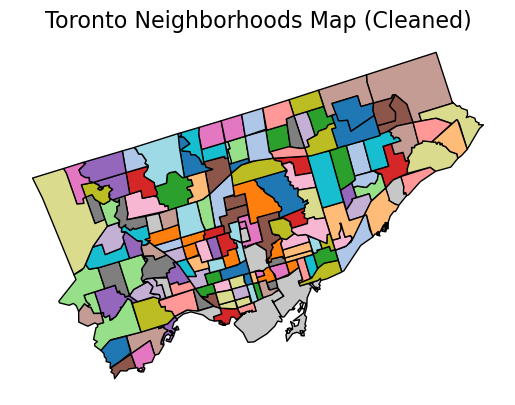

In [15]:
# Convert WKT strings to Shapely geometry objects
neighbourhoods_shapefiles_df['geometry'] = neighbourhoods_shapefiles_df['geometry'].apply(loads)

# Function to clean and decompose MultiPolygons into individual Polygons
def clean_geometries(geometry):
    if isinstance(geometry, MultiPolygon):
        return list(geometry.geoms)  # Decompose MultiPolygon
    elif isinstance(geometry, Polygon):
        return [geometry]  # Keep Polygon as a single item list
    else:
        return []  # Exclude unsupported geometry types

# Decompose MultiPolygons and rebuild the dataset
cleaned_rows = []
for idx, row in neighbourhoods_shapefiles_df.iterrows():
    geometries = clean_geometries(row['geometry'])
    for geom in geometries:
        new_row = row.copy()
        new_row['geometry'] = geom
        cleaned_rows.append(new_row)

# Create a new GeoDataFrame from the cleaned rows
neighbourhoods_simplified_gdf = gpd.GeoDataFrame(cleaned_rows, geometry='geometry')

# Set the CRS (Coordinate Reference System)
neighbourhoods_simplified_gdf.set_crs(epsg=4326, inplace=True)

# Simplify geometries for better performance
neighbourhoods_simplified_gdf['geometry'] = neighbourhoods_simplified_gdf['geometry'].simplify(tolerance=0.001, preserve_topology=True)

# Plot the cleaned geometries
plt.figure(figsize=(12, 8))
neighbourhoods_simplified_gdf.plot(column="AREA_NAME", legend=False, cmap="tab20", edgecolor="black")
plt.title("Toronto Neighborhoods Map (Cleaned)", fontsize=16)
plt.axis("off")
plt.show()

# Export the cleaned GeoDataFrame to a GeoJSON file for future use
#output_geojson_path = "clean_data/cleaned_neighbourhoods.geojson"
#neighbourhoods_simplified_gdf.to_file(output_geojson_path, driver="GeoJSON")
#print(f"Cleaned GeoDataFrame exported to {output_geojson_path}.")

Now let's overlay our diagram over toronto map.

In [16]:
# Convert to GeoDataFrame
toronto_hoods = gpd.GeoDataFrame(neighbourhoods_shapefiles_df, geometry='geometry')

# Set CRS for GeoDataFrame
toronto_hoods.set_crs(epsg=4326, inplace=True)

# Initialize a Folium map
toronto_map = folium.Map(location=[43.7, -79.4], zoom_start=11, tiles="CartoDB positron")

# Add neighborhood geometries to the map
for _, row in toronto_hoods.iterrows():
    # Add each neighborhood as a polygon on the map
    folium.GeoJson(
        row['geometry'],
        name=row.get('AREA_NAME', 'Unnamed Neighborhood'),
        tooltip=row.get('AREA_NAME', 'Unnamed Neighborhood')  # Show AREA_NAME on hover
    ).add_to(toronto_map)

# Display the map
display(toronto_map)
#toronto_map.save('EDA_maps/toronto_neighborhoods_map.html')
print("Map saved as 'toronto_neighborhoods_map.html'")

Map saved as 'toronto_neighborhoods_map.html'


In [17]:
# Get unique neighborhood names from the shapefile data
shapefile_names = toronto_hoods["AREA_NAME"].str.strip().str.lower().unique()

# Get unique neighborhood names from the income data
income_names = neighbourhood_income_and_population_df["Neighbourhood Name"].str.strip().str.lower().unique()

print(f"Number of neighborhoods in shapefile: {len(shapefile_names)}")
print(f"Number of neighborhoods in income data: {len(income_names)}")

Number of neighborhoods in shapefile: 158
Number of neighborhoods in income data: 140


In [18]:
# Define the mapping dictionary
name_mapping = {
    "malvern": ["malvern east", "malvern west", "morningside heights"],
    "bendale": ["bendale glen andrew", "bendale south"],
    "cabbagetown south st james town": ["cabbagetown south stjames town"],
    "church yonge corridor": ["church wellesley"],
    "dovercourt wallace emerson junction": ["dovercourt village", "junction wallace emerson"],
    "downsview roding cfb": ["downtown yonge east", "oakdale beverley heights", "downsview"],
    "willowdale east": ["east willowdale", "yonge doris", "avondale"],
    "islington city centre west": ["islington"],
    "lamoreaux": ["lamoreaux west", "east lamoreaux"],
    "mimico (includes humber bay shores)": ["mimico queensway", "etobicoke city centre", "humber bay shores"],
    "north st james town": ["north stjames town", "south eglinton davisville"],
    "woburn": ["woburn north", "golfdale cedarbrae woburn"],
    "rouge": ["west rouge"],
    "bay street corridor": ["yonge bay corridor", "bay cloverhill", "downtown yonge east"],
    "niagara": ["west queen west", "fort york liberty village"],
    "mount pleasant west": ["north toronto"],
    "waterfront communities the island": ["harbourfront cityplace", "st lawrence east bayfront the islands"],
    "parkwoods donalda": ["fenside parkwoods", "parkwoods oconnor hills", "wellington place"]
}

# Standardize and map names using name_mapping
def standardize_and_map_names(name, mapping):
    if isinstance(name, str):
        # Standardize the name
        standardized_name = (
            name.strip()
            .lower()
            .replace("-", " ")
            .replace("'", "")
            .replace(".", "")
            .replace(",", "")
        )
        # Check if the name matches any variations in the mapping
        for key, variations in mapping.items():
            if standardized_name in variations:
                return key
        return standardized_name
    return None

# Apply the function to both dataframes
toronto_hoods["Mapped_NAME"] = toronto_hoods["AREA_NAME"].apply(
    lambda x: standardize_and_map_names(x, name_mapping)
)
neighbourhood_income_and_population_df["Mapped_NAME"] = neighbourhood_income_and_population_df["Neighbourhood Name"].apply(
    lambda x: standardize_and_map_names(x, name_mapping)
)

In [19]:
# Merge the two datasets on the Mapped_NAME column
merged_gdf = toronto_hoods.merge(
    neighbourhood_income_and_population_df,
    on="Mapped_NAME",
    how="left"
)

# Check for any mismatched entries
mismatched_entries = merged_gdf[merged_gdf.isnull().any(axis=1)]

print(f"Number of unmatched entries: {len(mismatched_entries)}")

Number of unmatched entries: 0


In [20]:
# Export unmatched entries for review
#mismatched_entries.to_csv("clean_data/unmatched_entries.csv", index=False)
print("Unmatched entries saved to 'unmatched_entries.csv'.")

Unmatched entries saved to 'unmatched_entries.csv'.


In [21]:
# Normalize the "Average Income Midpoint" for a color gradient
import matplotlib

# Create a linear color map for average income
colormap = matplotlib.cm.ScalarMappable(
    norm=matplotlib.colors.Normalize(
        vmin=merged_gdf["Average Income Midpoint"].min(),
        vmax=merged_gdf["Average Income Midpoint"].max()
    ),
    cmap="YlGnBu"
)

# Add polygons to the Folium map
for _, row in merged_gdf.iterrows():
    income = row["Average Income Midpoint"]
    color = (
        matplotlib.colors.rgb2hex(colormap.to_rgba(income))
        if not pd.isnull(income)
        else "#d3d3d3"  # Default color for unmatched neighborhoods
    )
    folium.GeoJson(
        row["geometry"],
        name=row["Mapped_NAME"],
        tooltip=folium.Tooltip(
            f"<b>Neighborhood:</b> {row['Mapped_NAME']}<br>"
            f"<b>Population:</b> {row['Population, 2016']}<br>"
            f"<b>Average Income:</b> {row['Average Income']}"
        ),
        style_function=lambda x, color=color: {"fillColor": color, "color": "black", "weight": 0.5, "fillOpacity": 0.7},
    ).add_to(toronto_map)

# Save the updated map
display(toronto_map)
#toronto_map.save("EDA_maps/toronto_neighborhoods_income_map.html")
print("Map saved as 'toronto_neighborhoods_income_map.html'.")

Map saved as 'toronto_neighborhoods_income_map.html'.


In [22]:

# Generate a linear color map using matplotlib
cmap = matplotlib.cm.get_cmap("YlGnBu")
colors = [matplotlib.colors.rgb2hex(cmap(i)) for i in np.linspace(0, 1, 256)]

# Create a linear color map for average income using branca
colormap = cm.LinearColormap(
    colors=colors,
    vmin=merged_gdf["Average Income Midpoint"].min(),
    vmax=merged_gdf["Average Income Midpoint"].max(),
    caption="Average Income Midpoint"
)

# Add polygons to the Folium map
for _, row in merged_gdf.iterrows():
    income = row["Average Income Midpoint"]
    color = (
        colormap(income)
        if not pd.isnull(income)
        else "#d3d3d3"  # Default color for unmatched neighborhoods
    )
    folium.GeoJson(
        row["geometry"],
        name=row["Mapped_NAME"],
        tooltip=folium.Tooltip(
            f"<b>Neighborhood:</b> {row['Mapped_NAME']}<br>"
            f"<b>Population:</b> {row['Population, 2016']}<br>"
            f"<b>Average Income:</b> {row['Average Income']}"
        ),
        style_function=lambda x, color=color: {"fillColor": color, "color": "black", "weight": 0.5, "fillOpacity": 0.7},
    ).add_to(toronto_map)

# Add the color map legend to the map
colormap.add_to(toronto_map)

# Save the updated map
display(toronto_map)

C:\Users\clara\AppData\Local\Temp\ipykernel_19656\2648363831.py:2: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.



# Now let's introduce pollinate TO to our analysis

In [23]:
pollinateTO_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 149 entries, 0 to 148
Data columns (total 17 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   _id                     149 non-null    int64  
 1   ID                      149 non-null    int64  
 2   YEAR_FUNDED             149 non-null    int64  
 3   GROUP_NAME              149 non-null    object 
 4   PROJECT_NAME            149 non-null    object 
 5   GARDEN_TYPE             149 non-null    object 
 6   NUMBER_OF_GARDENS       149 non-null    int64  
 7   ESTIMATED_GARDEN_SIZE   149 non-null    float64
 8   NEIGHBOURHOOD_NUMBER    149 non-null    int64  
 9   NIA_OR_EN               38 non-null     object 
 10  PRIMARY_LOCATION_NAME   149 non-null    object 
 11  PRIMARY_GARDEN_ADDRESS  149 non-null    object 
 12  POSTAL_CODE             149 non-null    object 
 13  IS_INDIGENOUS_GARDEN    149 non-null    object 
 14  WARD_NAME               149 non-null    ob

In [24]:
pollinateTO_df.head(15)

,_id,ID,YEAR_FUNDED,GROUP_NAME,PROJECT_NAME,GARDEN_TYPE,NUMBER_OF_GARDENS,ESTIMATED_GARDEN_SIZE,NEIGHBOURHOOD_NUMBER,NIA_OR_EN,PRIMARY_LOCATION_NAME,PRIMARY_GARDEN_ADDRESS,POSTAL_CODE,IS_INDIGENOUS_GARDEN,WARD_NAME,WARD_NUMBER,geometry
0,1,1,2020,Appleton Ave. Community Organization,Appleton Ave. Pollinator Corridor,Multiple Front Yard Gardens,18,1250.00,92,NaN,Private Residential Property,14 Appleton Avenue,M6E 3A4,N,Davenport,9,MULTIPOINT (-79.43796221 43.67956399)
1,2,2,2020,Centre for Immigrant and Community Services (C...,The ENRICH Pollinator Garden,Communal Garden,4,114.25,128,NaN,Centre for Immigrant and Community Services,2330 Midland Avenue,M1S 5G5,N,Scarborough-Agincourt,22,MULTIPOINT (-79.2760134 43.77838864)
2,3,3,2020,Chester School Pollinator Garden Team,Chester School Pollinator Garden,School Learning Garden,1,34.00,57,NaN,Chester Elementary School,115 Gowan Avenue,M4K 2E4,N,Toronto-Danforth,14,MULTIPOINT (-79.35170998 43.68760238)
3,4,4,2020,CSPC - Transfiguration,Transfiguration Pollinator Garden,School Learning Garden,1,22.00,7,NaN,Transfiguration of Our Lord Catholic School,55 Ludstone Drive,M9R 2J2,N,Etobicoke Centre,2,MULTIPOINT (-79.56287403 43.69152984)
4,5,5,2020,Danforth Gardens Neighbourhood Association,Danforth Gardens Neighbourhood Pollinator Corr...,Multiple Front Yard Gardens,7,28.00,120,NaN,Private Residential Property,64 Clapperton Avenue,M1L 4K7,N,Scarborough Southwest,20,MULTIPOINT (-79.27634928 43.71211445)
5,6,6,2020,David Hornell Junior School & Mimico Residents...,David Hornell Pollinator Gardens,School Learning Garden,3,111.00,161,NaN,David Hornell Junior Public School,32 Victoria Street,M8V 1M6,N,Etobicoke-Lakeshore,3,MULTIPOINT (-79.48889366 43.61933328)
6,7,7,2020,Evergreen,Pollinator Revitalization Project,Communal Garden,6,123.00,56,NaN,Evergreen Brick Works,550 Bayview Avenue,M4W 3X8,N,University-Rosedale,11,MULTIPOINT (-79.36562797 43.68378335)
7,8,8,2020,FJR Pollinator Project,FJR Pollinator Garden,School Learning Garden,3,46.50,18,NaN,Father John Redmond Catholic Secondary School ...,28 Colonel Samuel Smith Park Drive,M8V 4B6,N,Etobicoke-Lakeshore,3,MULTIPOINT (-79.51653877 43.59514135)
8,9,9,2020,Garrison Creek Park Community Garden (GCPCG),Garrison Creek Park Pollinator Gardens,City Park,3,48.00,94,NaN,Garrison Creek Park,1090 Shaw Street,M6G 4B4,N,Toronto-St. Paul's,12,MULTIPOINT (-79.42730545 43.67169486)
9,10,10,2020,George Chuvalo Community Center & Christie Oss...,GCCC Gardens,Communal Garden,2,34.00,171,NaN,George Chuvalo Community Center,50 Sousa Mendes Street,M6P 3Z5,N,Davenport,9,MULTIPOINT (-79.45403412 43.66179166)


In [25]:
# Convert "YEAR_FUNDED" column to integer if it's not already
pollinateTO_df['YEAR_FUNDED'] = pd.to_numeric(pollinateTO_df['YEAR_FUNDED'], errors='coerce')

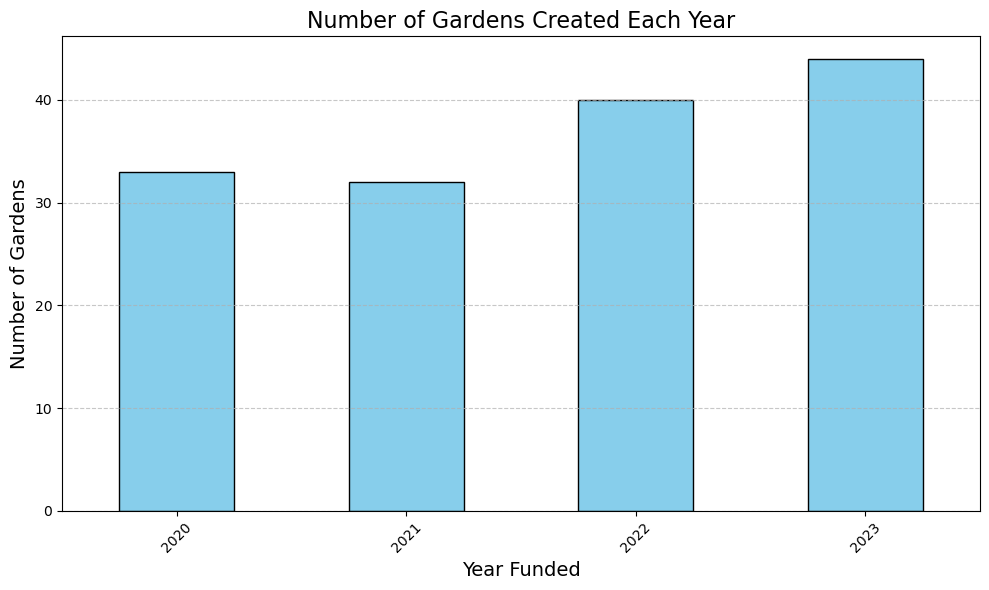

In [26]:
# 1. How many gardens were created each year?
gardens_per_year = pollinateTO_df['YEAR_FUNDED'].value_counts().sort_index()

plt.figure(figsize=(10, 6))
gardens_per_year.plot(kind='bar', color='skyblue', edgecolor='black')
plt.title('Number of Gardens Created Each Year', fontsize=16)
plt.xlabel('Year Funded', fontsize=14)
plt.ylabel('Number of Gardens', fontsize=14)
plt.xticks(rotation=45)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

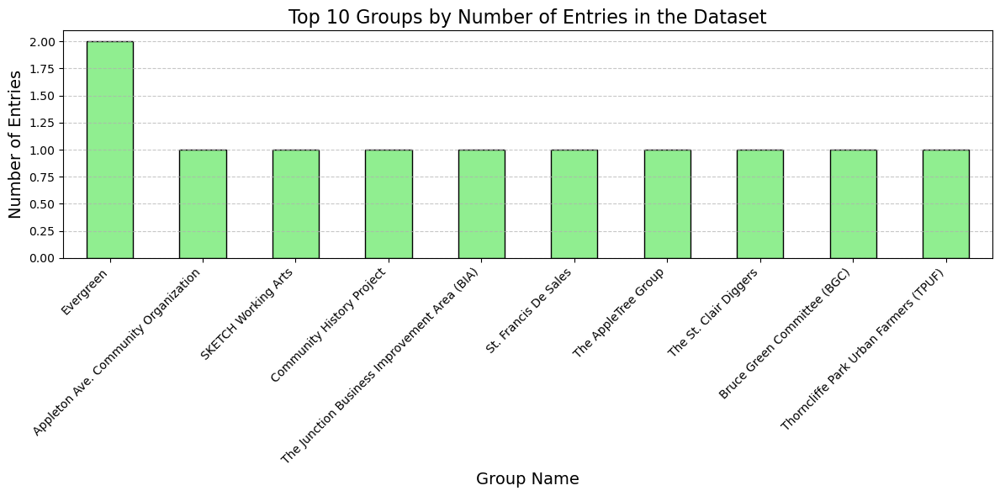

In [27]:
# Count how many times each group appears in the dataset
group_entry_count = pollinateTO_df['GROUP_NAME'].value_counts()

# Get the top 10 groups with the most entries
top_10_groups_by_entries = group_entry_count.head(10)

# Create a bar plot for the top 10 groups by number of entries
plt.figure(figsize=(12, 6))
top_10_groups_by_entries.plot(kind='bar', color='lightgreen', edgecolor='black')
plt.title('Top 10 Groups by Number of Entries in the Dataset', fontsize=16)
plt.xlabel('Group Name', fontsize=14)
plt.ylabel('Number of Entries', fontsize=14)
plt.xticks(rotation=45, ha='right')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

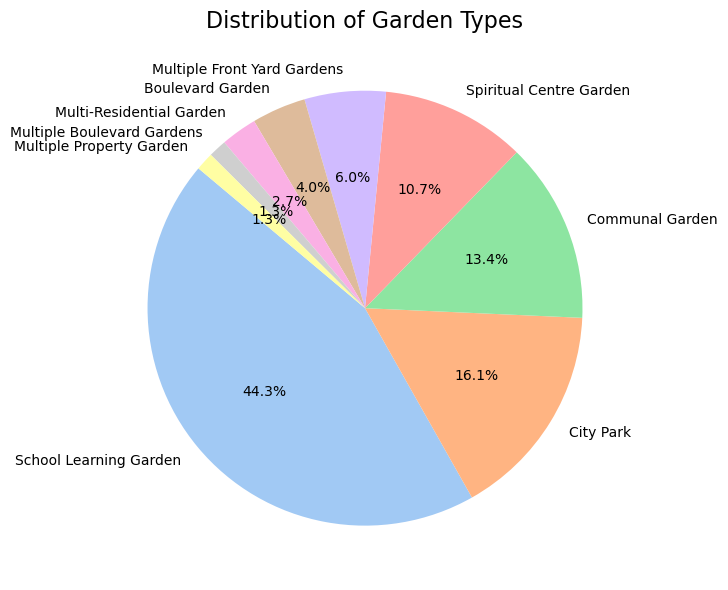

In [28]:
# 3. What are the garden types?
garden_types = pollinateTO_df['GARDEN_TYPE'].value_counts()

plt.figure(figsize=(10, 6))
garden_types.plot(kind='pie', autopct='%1.1f%%', startangle=140, colors=sns.color_palette("pastel"))
plt.title('Distribution of Garden Types', fontsize=16)
plt.ylabel('')  # Remove y-label for aesthetics
plt.tight_layout()
plt.show()

<Figure size 1200x800 with 0 Axes>

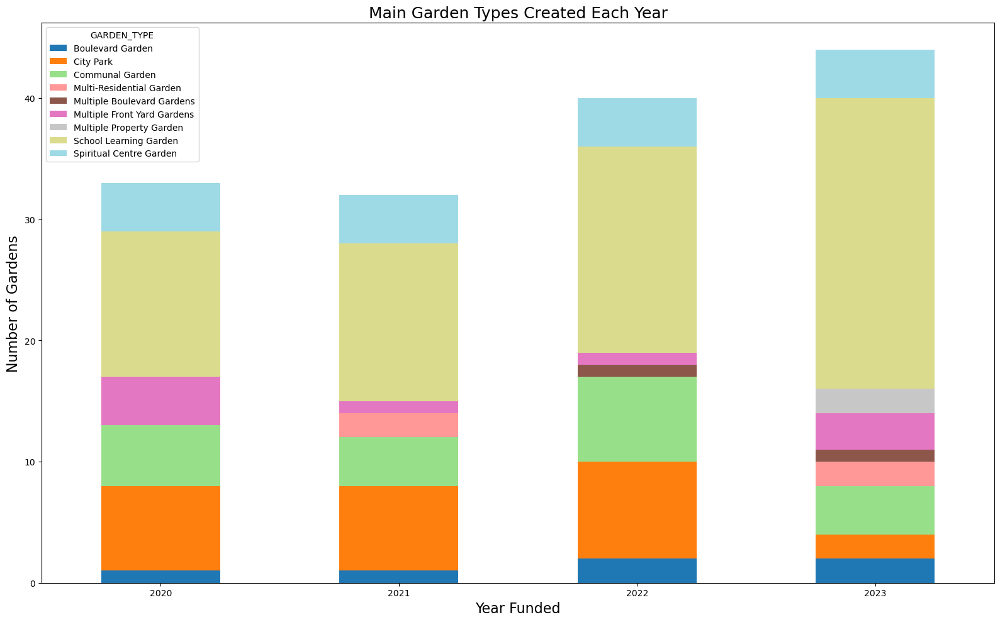

In [29]:
# 4. What were the main garden types created each year?
garden_types_per_year = pollinateTO_df.groupby(['YEAR_FUNDED', 'GARDEN_TYPE']).size().unstack(fill_value=0)

plt.figure(figsize=(12, 8))
garden_types_per_year.plot(kind='bar', stacked=True, colormap='tab20', figsize=(16, 10))
plt.title('Main Garden Types Created Each Year', fontsize=18)
plt.xlabel('Year Funded', fontsize=16)
plt.ylabel('Number of Gardens', fontsize=16)
plt.xticks(rotation=0)
plt.tight_layout()
plt.show()

let's combine incomes, gardens with year funded and neighbourhood profiles. first let's bring in year funded for gardens.

In [30]:
# # --- STEP 1: Prepare PollinateTO Garden Data ---
# pollinateTO_df['geometry'] = pollinateTO_df['geometry'].apply(loads)
# pollinateTO_gdf = gpd.GeoDataFrame(pollinateTO_df, geometry='geometry')
# pollinateTO_gdf.set_crs(epsg=4326, inplace=True)

# def extract_first_point(geometry):
#     if geometry.geom_type == "MultiPoint":
#         return list(geometry.geoms)[0]
#     elif geometry.geom_type == "Point":
#         return geometry
#     return None

# pollinateTO_gdf['geometry'] = pollinateTO_gdf['geometry'].apply(extract_first_point)
# pollinateTO_gdf = pollinateTO_gdf[pollinateTO_gdf['geometry'].notnull()]

# # --- STEP 2: Create Folium Map ---
# toronto_map = folium.Map(location=[43.7, -79.4], zoom_start=11, tiles="CartoDB positron")

# # Add neighborhood geometries with income coloring
# income_colormap = cm.ScalarMappable(
#     norm=Normalize(vmin=merged_gdf["Average Income Midpoint"].min(), vmax=merged_gdf["Average Income Midpoint"].max()),
#     cmap="YlGnBu"
# )

# for _, row in merged_gdf.iterrows():
#     income = row["Average Income Midpoint"]
#     color = (
#         rgb2hex(income_colormap.to_rgba(income))
#         if pd.notna(income)
#         else "#d3d3d3"  # Default color for unmatched neighborhoods
#     )
#     folium.GeoJson(
#         row['geometry'],
#         style_function=lambda x, color=color: {
#             "fillColor": color,
#             "color": "black",
#             "weight": 0.5,
#             "fillOpacity": 0.7,
#         },
#         tooltip=folium.Tooltip(
#             f"<b>Neighborhood:</b> {row['Mapped_NAME']}<br>"
#             f"<b>Population:</b> {row['Population, 2016']}<br>"
#             f"<b>Average Income:</b> {row['Average Income']}"
#         ),
#     ).add_to(toronto_map)

# # Add gardens with year-funded coloring
# years = pollinateTO_gdf['YEAR_FUNDED'].unique()
# year_colormap = cm.ScalarMappable(
#     norm=Normalize(vmin=years.min(), vmax=years.max()), cmap="viridis"
# )

# for _, row in pollinateTO_gdf.iterrows():
#     year = row["YEAR_FUNDED"]
#     garden_color = rgb2hex(year_colormap.to_rgba(year))
#     folium.CircleMarker(
#         location=[row.geometry.y, row.geometry.x],
#         radius=5,
#         color=garden_color,
#         fill=True,
#         fill_color=garden_color,
#         fill_opacity=0.8,
#         tooltip=folium.Tooltip(
#             f"<b>Project:</b> {row['PROJECT_NAME']}<br>"
#             f"<b>Year Funded:</b> {row['YEAR_FUNDED']}<br>"
#             f"<b>Group:</b> {row['GROUP_NAME']}<br>"
#             f"<b>Garden Type:</b> {row['GARDEN_TYPE']}"
#         ),
#     ).add_to(toronto_map)

# # --- STEP 3: Add Legends ---

# # Year-Funded Legend

# # Generate year_colors mapping
# year_colors = {year: rgb2hex(year_colormap.to_rgba(year)) for year in sorted(pollinateTO_gdf['YEAR_FUNDED'].unique())}

# # --- Custom Year-Funded Legend (List Format) ---
# legend_html = """
# <div style="position: fixed; 
#             bottom: 50px; left: 50px; width: 200px; height: auto; 
#             background-color: white; z-index:9999; font-size:14px;
#             border:2px solid grey; padding: 10px;">
#     <b>Year Funded Legend:</b><br>
# """
# # Create the legend items
# for year, color in year_colors.items():
#     legend_html += f"<i style='background: {color}; width: 15px; height: 15px; float: left; margin-right: 5px;'></i>{year}<br>"

# legend_html += "</div>"

# # Add the legend to the map
# legend = Element(legend_html)
# toronto_map.get_root().html.add_child(legend)
# display(toronto_map)

# # Save the map
# #toronto_map.save("EDA_maps/toronto_neighborhoods_with_gardens_and_legends.html")
# print("Map with income, gardens, and legends saved as 'toronto_neighborhoods_with_gardens_and_legends.html'.")


In [34]:
import folium
import geopandas as gpd
from shapely.wkt import loads
from shapely.geometry import MultiPoint, Point
import branca.colormap as cm
from folium import Element
from matplotlib.colors import rgb2hex
from matplotlib import cm as mpl_cm

# --- STEP 1: Prepare PollinateTO Garden Data ---

# If geometry is in WKT (string) format, you can load it using loads:
if isinstance(pollinateTO_df['geometry'].iloc[0], str):
    pollinateTO_df['geometry'] = pollinateTO_df['geometry'].apply(loads)

pollinateTO_gdf = gpd.GeoDataFrame(pollinateTO_df, geometry='geometry')

# Ensure the CRS is set correctly
pollinateTO_gdf.set_crs(epsg=4326, inplace=True)

# Function to handle MultiPoint geometries (get first point from MultiPoint)
def extract_first_point(geometry):
    if geometry.geom_type == "MultiPoint":
        return list(geometry.geoms)[0]  # Extract the first point from MultiPoint
    elif geometry.geom_type == "Point":
        return geometry  # Return the point directly
    return None  # Return None if it's not Point or MultiPoint

pollinateTO_gdf['geometry'] = pollinateTO_gdf['geometry'].apply(extract_first_point)

# Filter out any rows where the geometry is None (if applicable)
pollinateTO_gdf = pollinateTO_gdf[pollinateTO_gdf['geometry'].notnull()]

# --- STEP 2: Create Folium Map ---
toronto_map = folium.Map(location=[43.7, -79.4], zoom_start=11, tiles="CartoDB positron")

# Add neighborhood geometries with income coloring
# Use LinearColormap instead of ScalarMappable
income_colormap = cm.LinearColormap(
    colors=["#f7fbff", "#08306b"], 
    vmin=merged_gdf["Average Income Midpoint"].min(),
    vmax=merged_gdf["Average Income Midpoint"].max(),
    caption="Average Income Midpoint"
)

for _, row in merged_gdf.iterrows():
    income = row["Average Income Midpoint"]
    color = (
        income_colormap(income)  # Use the colormap function directly
        if pd.notna(income)
        else "#d3d3d3"  # Default color for unmatched neighborhoods
    )
    folium.GeoJson(
        row['geometry'],
        style_function=lambda x, color=color: {
            "fillColor": color,
            "color": "black",
            "weight": 0.5,
            "fillOpacity": 0.7,
        },
        tooltip=folium.Tooltip(
            f"<b>Neighborhood:</b> {row['Mapped_NAME']}<br>"
            f"<b>Population:</b> {row['Population, 2016']}<br>"
            f"<b>Average Income:</b> {row['Average Income']}"
        ),
    ).add_to(toronto_map)

# --- STEP: Add gardens with year-funded coloring ---
years = pollinateTO_gdf['YEAR_FUNDED'].unique()

# Using LinearColormap for year-funded colors with the 
year_colormap = cm.LinearColormap(
    colors=mpl_cm.get_cmap("tab20b").colors,  
    vmin=years.min(),
    vmax=years.max(),
    caption="Year Funded"
)

for _, row in pollinateTO_gdf.iterrows():
    year = row["YEAR_FUNDED"]
    garden_color = year_colormap(year) 
    folium.CircleMarker(
        location=[row.geometry.y, row.geometry.x],
        radius=5,
        color=garden_color,
        fill=True,
        fill_color=garden_color,
        fill_opacity=0.8,
        tooltip=folium.Tooltip(
            f"<b>Project:</b> {row['PROJECT_NAME']}<br>"
            f"<b>Year Funded:</b> {row['YEAR_FUNDED']}<br>"
            f"<b>Group:</b> {row['GROUP_NAME']}<br>"
            f"<b>Garden Type:</b> {row['GARDEN_TYPE']}"
        ),
    ).add_to(toronto_map)

# --- Custom Year-Funded Legend (List Format) ---
legend_html = """
<div style="position: fixed; 
            bottom: 50px; left: 50px; width: 200px; height: auto; 
            background-color: white; z-index:9999; font-size:14px;
            border:2px solid grey; padding: 10px;">
    <b>Year Funded Legend:</b><br>
"""

# Generate year_colors mapping based on year-funded data using the year_colormap
year_colors = {year: year_colormap(year) for year in sorted(pollinateTO_gdf['YEAR_FUNDED'].unique())}

# Create the legend items with colors
for year, color in year_colors.items():
    legend_html += f"<i style='background: {color}; width: 15px; height: 15px; float: left; margin-right: 5px;'></i>{year}<br>"

legend_html += "</div>"

# Add the legend to the map
legend = Element(legend_html)
toronto_map.get_root().html.add_child(legend)

# Display the map
display(toronto_map)

C:\Users\clara\AppData\Local\Temp\ipykernel_19656\290074130.py:73: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.



In [35]:
# --- STEP 1: Prepare PollinateTO Garden Data ---

# If geometry is in WKT (string) format, you can load it using loads:
if isinstance(pollinateTO_df['geometry'].iloc[0], str):
    pollinateTO_df['geometry'] = pollinateTO_df['geometry'].apply(loads)

pollinateTO_gdf = gpd.GeoDataFrame(pollinateTO_df, geometry='geometry')

# Ensure the CRS is set correctly
pollinateTO_gdf.set_crs(epsg=4326, inplace=True)

# Function to handle MultiPoint geometries (get first point from MultiPoint)
def extract_first_point(geometry):
    if geometry.geom_type == "MultiPoint":
        return list(geometry.geoms)[0]  # Extract the first point from MultiPoint
    elif geometry.geom_type == "Point":
        return geometry  # Return the point directly
    return None  # Return None if it's not Point or MultiPoint

pollinateTO_gdf['geometry'] = pollinateTO_gdf['geometry'].apply(extract_first_point)

# Filter out any rows where the geometry is None (if applicable)
pollinateTO_gdf = pollinateTO_gdf[pollinateTO_gdf['geometry'].notnull()]

# --- STEP 2: Create Folium Map ---
toronto_map = folium.Map(location=[43.7, -79.4], zoom_start=11, tiles="CartoDB positron")

# Add neighborhood geometries with income coloring
# Use LinearColormap instead of ScalarMappable
income_colormap = cm.LinearColormap(
    colors=["#f7fbff", "#08306b"], 
    vmin=merged_gdf["Average Income Midpoint"].min(),
    vmax=merged_gdf["Average Income Midpoint"].max(),
    caption="Average Income Midpoint"
)

for _, row in merged_gdf.iterrows():
    income = row["Average Income Midpoint"]
    color = (
        income_colormap(income)  # Use the colormap function directly
        if pd.notna(income)
        else "#d3d3d3"  # Default color for unmatched neighborhoods
    )
    folium.GeoJson(
        row['geometry'],
        style_function=lambda x, color=color: {
            "fillColor": color,
            "color": "black",
            "weight": 0.5,
            "fillOpacity": 0.7,
        },
        tooltip=folium.Tooltip(
            f"<b>Neighborhood:</b> {row['Mapped_NAME']}<br>"
            f"<b>Population:</b> {row['Population, 2016']}<br>"
            f"<b>Average Income:</b> {row['Average Income']}"
        ),
    ).add_to(toronto_map)

# --- STEP: Add gardens with year-funded coloring ---
years = pollinateTO_gdf['YEAR_FUNDED'].unique()

# Using LinearColormap for year-funded colors with the 
year_colormap = cm.LinearColormap(
    colors=mpl_cm.get_cmap("tab20b").colors,  
    vmin=years.min(),
    vmax=years.max(),
    caption="Year Funded"
)

for _, row in pollinateTO_gdf.iterrows():
    year = row["YEAR_FUNDED"]
    garden_color = year_colormap(year) 
    folium.CircleMarker(
        location=[row.geometry.y, row.geometry.x],
        radius=5,
        color=garden_color,
        fill=True,
        fill_color=garden_color,
        fill_opacity=0.8,
        tooltip=folium.Tooltip(
            f"<b>Project:</b> {row['PROJECT_NAME']}<br>"
            f"<b>Year Funded:</b> {row['YEAR_FUNDED']}<br>"
            f"<b>Group:</b> {row['GROUP_NAME']}<br>"
            f"<b>Garden Type:</b> {row['GARDEN_TYPE']}"
        ),
    ).add_to(toronto_map)

# --- Custom Income Legend (List Format) ---
legend_html_income = """
<div style="position: fixed; 
            bottom: 200px; left: 50px; width: 200px; height: auto; 
            background-color: white; z-index:9999; font-size:14px;
            border:2px solid grey; padding: 10px;">
    <b>Average Income Legend:</b><br>
"""
# Generate income_colors mapping based on income data using the income_colormap
income_colors = {
    f"{round(i, -4)}": rgb2hex(income_colormap(i))  # Round income to nearest 10,000
    for i in range(int(merged_gdf["Average Income Midpoint"].min()), int(merged_gdf["Average Income Midpoint"].max()) + 10000, 10000)
}

# Create the income legend items with colors
for income, color in income_colors.items():
    legend_html_income += f"<i style='background: {color}; width: 15px; height: 15px; float: left; margin-right: 5px;'></i>{income}<br>"

legend_html_income += "</div>"

# Add the income legend to the map
legend_income = Element(legend_html_income)
toronto_map.get_root().html.add_child(legend_income)

# --- Custom Year-Funded Legend (List Format) ---
legend_html_year = """
<div style="position: fixed; 
            bottom: 50px; left: 50px; width: 200px; height: auto; 
            background-color: white; z-index:9999; font-size:14px;
            border:2px solid grey; padding: 10px;">
    <b>Year Funded Legend:</b><br>
"""

# Generate year_colors mapping based on year-funded data using the year_colormap
year_colors = {year: year_colormap(year) for year in sorted(pollinateTO_gdf['YEAR_FUNDED'].unique())}

# Create the year legend items with colors
for year, color in year_colors.items():
    legend_html_year += f"<i style='background: {color}; width: 15px; height: 15px; float: left; margin-right: 5px;'></i>{year}<br>"

legend_html_year += "</div>"

# Add the year-funded legend to the map
legend_year = Element(legend_html_year)
toronto_map.get_root().html.add_child(legend_year)

# Display the map
display(toronto_map)

C:\Users\clara\AppData\Local\Temp\ipykernel_19656\1788428846.py:64: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.



now let's bring in garden type. 

In [36]:
from matplotlib.colors import ListedColormap
import random
from matplotlib import cm
from matplotlib.colors import ListedColormap
import seaborn as sns

# --- STEP 1: Create Folium Map ---
toronto_map = folium.Map(location=[43.7, -79.4], zoom_start=11, tiles="CartoDB positron")

# Add neighborhood geometries with income coloring
income_colormap = cm.ScalarMappable(
    norm=Normalize(vmin=merged_gdf["Average Income Midpoint"].min(), vmax=merged_gdf["Average Income Midpoint"].max()),
    cmap="YlGnBu"
)

for _, row in merged_gdf.iterrows():
    income = row["Average Income Midpoint"]
    color = (
        rgb2hex(income_colormap.to_rgba(income))
        if pd.notna(income)
        else "#d3d3d3"  # Default color for unmatched neighborhoods
    )
    folium.GeoJson(
        row['geometry'],
        style_function=lambda x, color=color: {
            "fillColor": color,
            "color": "black",
            "weight": 0.5,
            "fillOpacity": 0.7,
        },
        tooltip=folium.Tooltip(
            f"<b>Neighborhood:</b> {row['Mapped_NAME']}<br>"
            f"<b>Population:</b> {row['Population, 2016']}<br>"
            f"<b>Average Income:</b> {row['Average Income']}"
        ),
    ).add_to(toronto_map)

# --- STEP 2: Add Gardens with Garden Type Coloring ---
# Use a bright qualitative colormap for highly distinct and vibrant colors
garden_types = pollinateTO_gdf['GARDEN_TYPE'].unique()

# Generate distinct bright colors using Seaborn
palette = sns.color_palette("deep", n_colors=len(garden_types))  
type_colors = {g_type: rgb2hex(color) for g_type, color in zip(garden_types, palette)}

# Add garden points with updated vibrant colors
for _, row in pollinateTO_gdf.iterrows():
    g_type = row["GARDEN_TYPE"]
    garden_color = type_colors[g_type]
    folium.CircleMarker(
        location=[row.geometry.y, row.geometry.x],
        radius=5,
        color=garden_color,
        fill=True,
        fill_color=garden_color,
        fill_opacity=0.8,
        tooltip=folium.Tooltip(
            f"<b>Project:</b> {row['PROJECT_NAME']}<br>"
            f"<b>Garden Type:</b> {row['GARDEN_TYPE']}<br>"
            f"<b>Group:</b> {row['GROUP_NAME']}<br>"
            f"<b>Year Funded:</b> {row['YEAR_FUNDED']}"
        ),
    ).add_to(toronto_map)

# --- STEP 3: Add Garden Type Legend ---
legend_html = """
<div style="position: fixed; 
            bottom: 50px; left: 50px; width: 250px; height: auto; 
            background-color: white; z-index:9999; font-size:14px;
            border:2px solid grey; padding: 10px;">
    <b>Garden Type Legend:</b><br>
"""
for g_type, color in type_colors.items():
    legend_html += f"<i style='background: {color}; width: 15px; height: 15px; float: left; margin-right: 5px;'></i>{g_type}<br>"

legend_html += "</div>"

# Add the legend to the map
legend = Element(legend_html)
toronto_map.get_root().html.add_child(legend)

# Save the updated map
display(toronto_map)
#toronto_map.save("EDA_maps/toronto_neighborhoods_with_bright_garden_types.html")
print("Map with brighter garden type colors saved as 'toronto_neighborhoods_with_bright_garden_types.html'.")


Map with brighter garden type colors saved as 'toronto_neighborhoods_with_bright_garden_types.html'.


In [37]:
import folium
import geopandas as gpd
from shapely.wkt import loads
from shapely.geometry import MultiPoint, Point
import branca.colormap as cm
from folium import Element
from matplotlib.colors import Normalize, rgb2hex
import seaborn as sns
import pandas as pd
# --- STEP 1: Create Folium Map ---
toronto_map = folium.Map(location=[43.7, -79.4], zoom_start=11, tiles="CartoDB positron")

# Add neighborhood geometries with income coloring
income_colormap = cm.LinearColormap(
    colors=["#f7fbff", "#08306b"], 
    vmin=merged_gdf["Average Income Midpoint"].min(), 
    vmax=merged_gdf["Average Income Midpoint"].max(), 
    caption="Average Income Midpoint"
)

for _, row in merged_gdf.iterrows():
    income = row["Average Income Midpoint"]
    color = (
        income_colormap(income)
        if pd.notna(income)
        else "#d3d3d3"  # Default color for unmatched neighborhoods
    )
    folium.GeoJson(
        row['geometry'],
        style_function=lambda x, color=color: {
            "fillColor": color,
            "color": "black",
            "weight": 0.5,
            "fillOpacity": 0.7,
        },
        tooltip=folium.Tooltip(
            f"<b>Neighborhood:</b> {row['Mapped_NAME']}<br>"
            f"<b>Population:</b> {row['Population, 2016']}<br>"
            f"<b>Average Income:</b> {row['Average Income']}"
        ),
    ).add_to(toronto_map)

# --- STEP 2: Add Gardens with Garden Type Coloring ---
garden_types = pollinateTO_gdf['GARDEN_TYPE'].unique()

# Generate distinct colors for garden types
palette = sns.color_palette("deep", n_colors=len(garden_types))
type_colors = {g_type: rgb2hex(color) for g_type, color in zip(garden_types, palette)}

for _, row in pollinateTO_gdf.iterrows():
    g_type = row["GARDEN_TYPE"]
    garden_color = type_colors[g_type]
    folium.CircleMarker(
        location=[row.geometry.y, row.geometry.x],
        radius=5,
        color=garden_color,
        fill=True,
        fill_color=garden_color,
        fill_opacity=0.8,
        tooltip=folium.Tooltip(
            f"<b>Project:</b> {row['PROJECT_NAME']}<br>"
            f"<b>Garden Type:</b> {row['GARDEN_TYPE']}<br>"
            f"<b>Group:</b> {row['GROUP_NAME']}<br>"
            f"<b>Year Funded:</b> {row['YEAR_FUNDED']}"
        ),
    ).add_to(toronto_map)

# --- STEP 3: Add Legends ---

# Garden Type Legend
legend_html = """
<div style="position: fixed; 
            bottom: 50px; left: 50px; width: 250px; height: auto; 
            background-color: white; z-index:9999; font-size:14px;
            border:2px solid grey; padding: 10px;">
    <b>Garden Type Legend:</b><br>
"""
for g_type, color in type_colors.items():
    legend_html += f"<i style='background: {color}; width: 15px; height: 15px; float: left; margin-right: 5px;'></i>{g_type}<br>"
legend_html += "</div>"

# Income Legend
income_legend_html = """
<div style="position: fixed; 
            bottom: 280px; left: 50px; width: 250px; height: auto; 
            background-color: white; z-index:9999; font-size:14px;
            border:2px solid grey; padding: 10px;">
    <b>Income Legend:</b><br>
"""

# Round income range to the nearest 10,000 and display ticks at every 10,000
rounded_min = int(merged_gdf["Average Income Midpoint"].min() // 10000 * 10000)
rounded_max = int(merged_gdf["Average Income Midpoint"].max() // 10000 * 10000) + 10000

income_ticks = range(rounded_min, rounded_max + 1, 10000)

for income in income_ticks:
    color = income_colormap(income)
    income_legend_html += f"<i style='background: {color}; width: 15px; height: 15px; float: left; margin-right: 5px;'></i>{income:,}<br>"

income_legend_html += "</div>"

# Add legends to the map
garden_legend = Element(legend_html)
income_legend = Element(income_legend_html)
toronto_map.get_root().html.add_child(garden_legend)
toronto_map.get_root().html.add_child(income_legend)

# Display the map
display(toronto_map)

# Now we want to introduce schools to our analysis

In [38]:
schools_df.head()

,_id,OBJECTID,GEO_ID,NAME,BOARD_NAME,SOURCE_ADDRESS,ADDRESS_POINT_ID,ADDRESS_NUMBER,ADDRESS_FULL,POSTAL_CODE,MUNICIPALITY,CITY,PLACE_NAME,CENTRELINE_ID,geometry
0,1,1,330677,A PLUS ACADEMY OF ADVANCEMENT,NaN,2425 EGLINTON AVE E,330677,2425,2425 Eglinton Ave E,M1K 5G8,Scarborough,Toronto,NaN,111254,MULTIPOINT (-79.267103936897 43.7320819460129)
1,2,2,524780,A R S ARMENIAN PRIVATE SCHOOL,NaN,50 HALLCROWN PL,524780,50,50 Hallcrown Pl,M2J 1P7,North York,Toronto,NaN,438652,MULTIPOINT (-79.323156147744 43.770053062482)
2,3,3,20258267,A Y J GLOBAL ACADEMY,NaN,4 LANSING SQ,20258267,4,4 Lansing Sq,M2J 5A2,North York,Toronto,NaN,438287,MULTIPOINT (-79.3252164120635 43.774082570705)
3,4,4,517961,A Y JACKSON SECONDARY SCHOOL,Toronto District School Board,50 FRANCINE DR,517961,50,50 Francine Dr,M2H 2G6,North York,Toronto,A. Y. Jackson Secondary School,436260,MULTIPOINT (-79.3665552934095 43.8052613014219)
4,5,5,13967401,ABACUS MONTESSORI LEARNING CENTRE,NaN,4 CREDIT UNION DR,13967401,4,4 Credit Union Dr,M4A 2N8,North York,Toronto,Latvian Canadian Centre,444179,MULTIPOINT (-79.3190099774403 43.725432232812)


In [39]:
from shapely.wkt import loads
import geopandas as gpd

# Convert geometry to Shapely objects and create GeoDataFrame
schools_df['geometry'] = schools_df['geometry'].apply(loads)
schools_gdf = gpd.GeoDataFrame(schools_df, geometry='geometry', crs="EPSG:4326")

# Extract the first point from MULTIPOINT geometries
def extract_first_point(geometry):
    if geometry.geom_type == "MultiPoint":
        return list(geometry.geoms)[0]
    elif geometry.geom_type == "Point":
        return geometry
    return None

schools_gdf['geometry'] = schools_gdf['geometry'].apply(extract_first_point)

# Drop rows with null geometries (if any)
schools_gdf = schools_gdf[schools_gdf['geometry'].notnull()]

# Display the cleaned GeoDataFrame
schools_gdf.head()

,_id,OBJECTID,GEO_ID,NAME,BOARD_NAME,SOURCE_ADDRESS,ADDRESS_POINT_ID,ADDRESS_NUMBER,ADDRESS_FULL,POSTAL_CODE,MUNICIPALITY,CITY,PLACE_NAME,CENTRELINE_ID,geometry
0,1,1,330677,A PLUS ACADEMY OF ADVANCEMENT,NaN,2425 EGLINTON AVE E,330677,2425,2425 Eglinton Ave E,M1K 5G8,Scarborough,Toronto,NaN,111254,POINT (-79.2671 43.73208)
1,2,2,524780,A R S ARMENIAN PRIVATE SCHOOL,NaN,50 HALLCROWN PL,524780,50,50 Hallcrown Pl,M2J 1P7,North York,Toronto,NaN,438652,POINT (-79.32316 43.77005)
2,3,3,20258267,A Y J GLOBAL ACADEMY,NaN,4 LANSING SQ,20258267,4,4 Lansing Sq,M2J 5A2,North York,Toronto,NaN,438287,POINT (-79.32522 43.77408)
3,4,4,517961,A Y JACKSON SECONDARY SCHOOL,Toronto District School Board,50 FRANCINE DR,517961,50,50 Francine Dr,M2H 2G6,North York,Toronto,A. Y. Jackson Secondary School,436260,POINT (-79.36656 43.80526)
4,5,5,13967401,ABACUS MONTESSORI LEARNING CENTRE,NaN,4 CREDIT UNION DR,13967401,4,4 Credit Union Dr,M4A 2N8,North York,Toronto,Latvian Canadian Centre,444179,POINT (-79.31901 43.72543)


In [50]:
import folium
from matplotlib.colors import rgb2hex, Normalize
from matplotlib import cm
from branca.element import Element

# Initialize the map
toronto_map = folium.Map(location=[43.7, -79.4], zoom_start=11, tiles="CartoDB positron")

# --- Add Income by Neighborhood ---
# Normalize income values for color mapping
income_colormap = cm.ScalarMappable(
    norm=Normalize(vmin=merged_gdf["Average Income Midpoint"].min(), vmax=merged_gdf["Average Income Midpoint"].max()),
    cmap="YlGnBu"
)

# Add neighborhood shapes with income coloring
for _, row in merged_gdf.iterrows():
    income = row["Average Income Midpoint"]
    color = rgb2hex(income_colormap.to_rgba(income)) if pd.notna(income) else "#d3d3d3"  # Default for unmatched
    folium.GeoJson(
        row['geometry'],
        style_function=lambda x, color=color: {
            "fillColor": color,
            "color": "black",
            "weight": 0.5,
            "fillOpacity": 0.7,
        },
        tooltip=folium.Tooltip(
            f"<b>Neighborhood:</b> {row['Mapped_NAME']}<br>"
            f"<b>Population:</b> {row['Population, 2016']}<br>"
            f"<b>Average Income:</b> {row['Average Income']}"
        ),
    ).add_to(toronto_map)

# --- Add Schools ---
# Add school locations as red points
# Add Schools as Smaller Points
for _, row in schools_gdf.iterrows():
    folium.CircleMarker(
        location=[row.geometry.y, row.geometry.x],
        radius=2,  # Reduced radius for smaller points
        color="magenta",
        fill=True,
        fill_color="magenta",
        fill_opacity=0.8,
        tooltip=folium.Tooltip(
            f"<b>School Name:</b> {row['NAME']}<br>"
            f"<b>Board:</b> {row['BOARD_NAME']}<br>"
            f"<b>Address:</b> {row['ADDRESS_FULL']}"
        ),
    ).add_to(toronto_map)

# --- Add Gardens ---
# Distinguish School Learning Gardens from other gardens
for _, row in pollinateTO_gdf.iterrows():
    is_school_garden = row["GARDEN_TYPE"] == "School Learning Garden"
    color = "green" if is_school_garden else "blue"
    folium.CircleMarker(
        location=[row.geometry.y, row.geometry.x],
        radius=5,
        color=color,
        fill=True,
        fill_color=color,
        fill_opacity=0.8,
        tooltip=folium.Tooltip(
            f"<b>Project:</b> {row['PROJECT_NAME']}<br>"
            f"<b>Garden Type:</b> {row['GARDEN_TYPE']}<br>"
            f"<b>Group:</b> {row['GROUP_NAME']}<br>"
            f"<b>Year Funded:</b> {row['YEAR_FUNDED']}"
        ),
    ).add_to(toronto_map)


    
# --- Add Legends ---
legend_html = """
<div style="position: fixed; 
            bottom: 50px; left: 50px; width: 250px; height: auto; 
            background-color: white; z-index:9999; font-size:14px;
            border:2px solid grey; padding: 10px;">
    <b>Legend:</b><br>
    <i style='background: blue; width: 15px; height: 15px; float: left; margin-right: 5px;'></i>School Learning Garden<br>
    <i style='background: green; width: 15px; height: 15px; float: left; margin-right: 5px;'></i>Other Garden<br>
    <i style='background: magenta; width: 15px; height: 15px; float: left; margin-right: 5px;'></i>School Location<br>
</div>
"""
# --- Add Legends ---
legend_html = """
<div style="position: fixed; 
            bottom: 50px; left: 50px; width: 250px; height: auto; 
            background-color: white; z-index:9999; font-size:14px;
            border:2px solid grey; padding: 10px;">
    <b>Legend:</b><br>
    <i style='background: green; width: 15px; height: 15px; float: left; margin-right: 5px;'></i>School Learning Garden<br>
    <i style='background: blue; width: 15px; height: 15px; float: left; margin-right: 5px;'></i>Other Garden<br>
    <i style='background: magenta; width: 15px; height: 15px; float: left; margin-right: 5px;'></i>School Location<br>
    <br><b>Income Legend:</b><br>
"""

# Generate rounded income ranges for the legend
income_min = merged_gdf["Average Income Midpoint"].min()
income_max = merged_gdf["Average Income Midpoint"].max()
income_intervals = list(range(int(income_min // 10000) * 10000, int(income_max // 10000) * 10000 + 10000, 10000))

# Add income colors to the legend
for i in range(len(income_intervals) - 1):
    start = income_intervals[i]
    end = income_intervals[i + 1]
    color = rgb2hex(income_colormap.to_rgba((start + end) / 2))  # Use midpoint for color
    legend_html += f"<i style='background: {color}; width: 15px; height: 15px; float: left; margin-right: 5px;'></i>{start} - {end}<br>"

legend_html += "</div>"

# Add the legend to the map

legend = Element(legend_html)
toronto_map.get_root().html.add_child(legend)

display(toronto_map)

# Save the map
#map_path = "EDA_maps/toronto_income_gardens_schools.html"
#toronto_map.save(map_path)
#map_path


# Now let's take a look at existing parks

In [51]:
parks_df.head()

,_id,LOCATIONID,ASSET_ID,ASSET_NAME,TYPE,AMENITIES,ADDRESS,PHONE,URL,geometry
0,1,298,1126,WILLIAMSON PARK RAVINE,Park,NaN,1680 GERRARD ST E,NaN,https://www.toronto.ca/data/parks/prd/faciliti...,MULTIPOINT (-79.3173566254804 43.6780549678585)
1,2,2342,1328,GLENELLEN PARKETTE,Park,NaN,63 GLENELLEN DR E,NaN,https://www.toronto.ca/data/parks/prd/faciliti...,MULTIPOINT (-79.4954482404427 43.640619013426)
2,3,2281,1317,GATEWAY PARK,Park,NaN,40 EAST LIBERTY ST,NaN,https://www.toronto.ca/data/parks/prd/faciliti...,MULTIPOINT (-79.4119174331757 43.6393331052003)
3,4,1030,964,SMITHWOOD PARK,Park,Playground,79 SMITHWOOD DR,NaN,https://www.toronto.ca/data/parks/prd/faciliti...,MULTIPOINT (-79.5507058668245 43.6408874593971)
4,5,2544,816,PETER STREET BASIN PARK,Park,NaN,370 QUEENS QUAY W,NaN,https://www.toronto.ca/data/parks/prd/faciliti...,MULTIPOINT (-79.3897486591197 43.6384910224043)


In [52]:
# Convert geometry to Shapely objects and create GeoDataFrame
parks_df['geometry'] = parks_df['geometry'].apply(loads)
parks_gdf = gpd.GeoDataFrame(parks_df, geometry='geometry', crs="EPSG:4326")

# Extract the first point from MULTIPOINT geometries
parks_gdf['geometry'] = parks_gdf['geometry'].apply(extract_first_point)

# Drop rows with null geometries (if any)
parks_gdf = parks_gdf[parks_gdf['geometry'].notnull()]

# Display the cleaned GeoDataFrame
parks_gdf.head()

,_id,LOCATIONID,ASSET_ID,ASSET_NAME,TYPE,AMENITIES,ADDRESS,PHONE,URL,geometry
0,1,298,1126,WILLIAMSON PARK RAVINE,Park,NaN,1680 GERRARD ST E,NaN,https://www.toronto.ca/data/parks/prd/faciliti...,POINT (-79.31736 43.67805)
1,2,2342,1328,GLENELLEN PARKETTE,Park,NaN,63 GLENELLEN DR E,NaN,https://www.toronto.ca/data/parks/prd/faciliti...,POINT (-79.49545 43.64062)
2,3,2281,1317,GATEWAY PARK,Park,NaN,40 EAST LIBERTY ST,NaN,https://www.toronto.ca/data/parks/prd/faciliti...,POINT (-79.41192 43.63933)
3,4,1030,964,SMITHWOOD PARK,Park,Playground,79 SMITHWOOD DR,NaN,https://www.toronto.ca/data/parks/prd/faciliti...,POINT (-79.55071 43.64089)
4,5,2544,816,PETER STREET BASIN PARK,Park,NaN,370 QUEENS QUAY W,NaN,https://www.toronto.ca/data/parks/prd/faciliti...,POINT (-79.38975 43.63849)


In [55]:
# Initialize a new Folium map
toronto_map_parks = folium.Map(location=[43.7, -79.4], zoom_start=11, tiles="CartoDB positron")

# --- Add Neighborhood Income Layers ---
# Normalize income values for color mapping
income_colormap = cm.ScalarMappable(
    norm=Normalize(vmin=merged_gdf["Average Income Midpoint"].min(), vmax=merged_gdf["Average Income Midpoint"].max()),
    cmap="YlGnBu"
)

for _, row in merged_gdf.iterrows():
    income = row["Average Income Midpoint"]
    color = rgb2hex(income_colormap.to_rgba(income)) if pd.notna(income) else "#d3d3d3"
    folium.GeoJson(
        row['geometry'],
        style_function=lambda x, color=color: {
            "fillColor": color,
            "color": "black",
            "weight": 0.5,
            "fillOpacity": 0.7,
        },
        tooltip=folium.Tooltip(
            f"<b>Neighborhood:</b> {row['Mapped_NAME']}<br>"
            f"<b>Population:</b> {row.get('Population, 2016', 'N/A')}<br>"
            f"<b>Average Income:</b> {row.get('Average Income', 'N/A')}"
        ),
    ).add_to(toronto_map_parks)

# --- Add Gardens ---
# Add all gardens as one group
for _, row in pollinateTO_gdf.iterrows():
    folium.CircleMarker(
        location=[row.geometry.y, row.geometry.x],
        radius=4,  # Adjusted size
        color="green",  # Uniform color for all gardens
        fill=True,
        fill_color="green",
        fill_opacity=0.8,
        tooltip=folium.Tooltip(
            f"<b>Project:</b> {row['PROJECT_NAME']}<br>"
            f"<b>Garden Type:</b> {row['GARDEN_TYPE']}<br>"
            f"<b>Group:</b> {row['GROUP_NAME']}<br>"
            f"<b>Year Funded:</b> {row['YEAR_FUNDED']}"
        ),
    ).add_to(toronto_map_parks)


# --- Add Parks ---
for _, row in parks_gdf.iterrows():
    folium.CircleMarker(
        location=[row.geometry.y, row.geometry.x],
        radius=3,  # Smaller size for parks
        color="orange",
        fill=True,
        fill_color="orange",
        fill_opacity=0.8,
        tooltip=folium.Tooltip(
            f"<b>Park Name:</b> {row['ASSET_NAME']}<br>"
            f"<b>Type:</b> {row['TYPE']}<br>"
            f"<b>Address:</b> {row['ADDRESS']}"
        ),
    ).add_to(toronto_map_parks)

legend_html = """
<div style="position: fixed; 
            bottom: 50px; left: 50px; width: 250px; height: auto; 
            background-color: white; z-index:9999; font-size:14px;
            border:2px solid grey; padding: 10px;">
    <b>Legend:</b><br>
    <i style='background: green; width: 15px; height: 15px; float: left; margin-right: 5px;'></i>Garden<br>
    <i style='background: orange; width: 15px; height: 15px; float: left; margin-right: 5px;'></i>Park<br>
</div>
"""


legend = Element(legend_html)
toronto_map_parks.get_root().html.add_child(legend)

display(toronto_map_parks)

# Save the map
# parks_map_path = "EDA_maps/toronto_income_gardens_parks.html"
# toronto_map_parks.save(parks_map_path)
# parks_map_path

# Lastly let's bring in development applications data

In [ ]:
import geopandas as gpd
import pandas as pd
from shapely.geometry import Point
import folium
from pyproj import Transformer

# Load the dataset
file_path = "raw_data/Development_Applications_development_applications.csv"  # Replace with actual file path
development_df = pd.read_csv(file_path)

# --- Step 1: Transform X, Y to Latitude and Longitude ---
# Attempt using Web Mercator (EPSG:3857) -> WGS84 (EPSG:4326)
transformer = Transformer.from_crs("EPSG:3857", "EPSG:4326", always_xy=True)

# Apply transformation to create latitude and longitude columns
development_df["LATITUDE"], development_df["LONGITUDE"] = zip(
    *development_df.apply(
        lambda row: transformer.transform(row["X"], row["Y"]) if pd.notna(row["X"]) and pd.notna(row["Y"]) else (None, None),
        axis=1
    )
)

# Debug Step: Check Transformed Coordinates
print("Transformed Coordinates (Alternative CRS, Sample):")
print(development_df[["X", "Y", "LATITUDE", "LONGITUDE"]].head())

# --- Step 2: Filter Valid Development Points ---
# Filter points within a plausible range for Toronto
valid_development_df = development_df[
    development_df["LATITUDE"].notna() & 
    development_df["LONGITUDE"].notna() & 
    (development_df["LATITUDE"].between(43.6, 43.9)) & 
    (development_df["LONGITUDE"].between(-79.6, -79.0))
]

print("\nValid Development Points Count:", len(valid_development_df))
if len(valid_development_df) == 0:
    print("No valid development points found! Please check your data.")

# --- Step 3: Create a GeoDataFrame ---
development_gdf = gpd.GeoDataFrame(
    valid_development_df,
    geometry=gpd.points_from_xy(valid_development_df["LONGITUDE"], valid_development_df["LATITUDE"]),
    crs="EPSG:4326"
)

# --- Step 4: Initialize Folium Map ---
toronto_map_developments = folium.Map(location=[43.7, -79.4], zoom_start=11, tiles="CartoDB positron")

# --- Step 5: Add Development Points ---
for _, row in development_gdf.iterrows():
    description = row["DESCRIPTION"] if pd.notna(row["DESCRIPTION"]) else "No description available"
    folium.CircleMarker(
        location=[row["LATITUDE"], row["LONGITUDE"]],
        radius=5,
        color="red",
        fill=True,
        fill_color="red",
        fill_opacity=0.8,
        tooltip=folium.Tooltip(
            f"<b>Development Address:</b> {row['STREET_NUM']} {row['STREET_NAME']} {row.get('STREET_TYPE', '')}<br>"
            f"<b>Status:</b> {row['STATUS']}<br>"
            f"<b>Ward Name:</b> {row['WARD_NAME']}<br>"
            f"<b>Description:</b> {description[:150]}..."  # Truncated description
        ),
    ).add_to(toronto_map_developments)

# --- Step 6: Add Legends ---
legend_html = """
<div style="position: fixed; 
            bottom: 50px; left: 50px; width: 250px; height: auto; 
            background-color: white; z-index:9999; font-size:14px;
            border:2px solid grey; padding: 10px;">
    <b>Legend:</b><br>
    <i style='background: red; width: 15px; height: 15px; float: left; margin-right: 5px;'></i>Development Location<br>
</div>
"""
from branca.element import Element
legend = Element(legend_html)
toronto_map_developments.get_root().html.add_child(legend)

# --- Step 7: Save and Display Map ---
map_path = "EDA_maps/toronto_development_map.html"
toronto_map_developments.save(map_path)
print(f"Map saved to {map_path}")



Transformed Coordinates (Alternative CRS, Sample):
            X            Y  LATITUDE  LONGITUDE
0  322403.434  4837700.947  2.896199  39.805381
1  322391.759  4837712.879  2.896094  39.805463
2  322405.443  4837725.206  2.896217  39.805548
3  323517.010  4843009.424  2.906203  39.842005
4  323518.740  4842979.297  2.906218  39.841798

Valid Development Points Count: 0
No valid development points found! Please check your data.
Map saved to EDA_maps/toronto_development_map.html


In [ ]:
print(development_gdf[["LATITUDE", "LONGITUDE"]].head())
print(development_gdf[["LATITUDE", "LONGITUDE"]].describe())
print(development_gdf[["LATITUDE", "LONGITUDE"]].isna().sum())


Empty DataFrame
Columns: [LATITUDE, LONGITUDE]
Index: []
       LATITUDE  LONGITUDE
count       0.0        0.0
mean        NaN        NaN
std         NaN        NaN
min         NaN        NaN
25%         NaN        NaN
50%         NaN        NaN
75%         NaN        NaN
max         NaN        NaN
LATITUDE     0
LONGITUDE    0
dtype: int64
